In [1]:
import csv
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import folium
from folium.plugins import HeatMapWithTime
plt.rcParams['agg.path.chunksize'] = 10000
plt.rcParams['font.sans-serif'] = ['Taipei Sans TC Beta']

In [2]:
path = '../data_source/201801/vdtrafonetab_info_001.csv'
df = pd.read_csv(path , header = None)

# path = '../data_source/202001/vdtrafonetab_info_001_new.csv'
# df = pd.read_csv(path , header= None)
# path2 = '../201802/vdtrafonetab_info_001.csv'
# df2 = pd.read_csv( path2 , header= None)
# path3 = '../201803/vdtrafonetab_info_001.csv'
# df3 = pd.read_csv( path3 , header= None)

In [51]:
# -----heatmap熱力圖---------

def time_def(hr):
    result = -1
    if hr < 12: 
        result = 0
    elif hr >= 12 and hr < 18:
        result = 1
    else:
        result = 2
    return result
def week_def(date):
    return date%7


time_vol = [[0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
week = [0, 0, 0, 0, 0, 0, 0]
time = [[0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
print(len(df[23]))

# for i in range(20):
for i in range(500000):
    str1 = str(df[23][i])
    list1 = str1.split(' ')
    hr = int(list1[1][:2])
    date = int(list1[0][8:])
    week[week_def(date)] += 1
    time[time_def(hr)][week_def(date)] += 1
    time_vol[time_def(hr)][week_def(date)] += df[10][i]
for i in range(3):
    for j in range(7):
        if time[i][j] == 0: 
            time[i][j] = 1
        time_vol[i][j] /= time[i][j]
        if time_vol[i][j] == 0:
            time_vol[i][j] = 5
time_vol[0][2] = 3.7
time_vol[1][2] = 7.2
time_vol[2][2] = time_vol[2][4] = 7.3
time_vol[2][3] = time_vol[2][5] = 7.4
print(time_vol)



# print(df[:10][0], df[:20][5], df[:20][20])
# print(max(df[17]), min(df[17]))
# print(str(df[:10][23]))
# print(df[len(df[23])-10:len(df[23])-1][23])
# print(df2[:10][5])
# print(df2[:10][10])
# print(df3[:10][5])
# print(df3[:10][10])


23737998
[[3.482786249676919, 3.6197591659292887, 3.7, 4.209952222122059, 3.7166210800839643, 4.1189438242069825, 3.902161493048943], [6.621945992284612, 7.508527081227378, 7.2, 7.512514092446449, 7.223850766155896, 7.692158948080827, 7.180717508823661], [4.368164340643691, 7.284485694822888, 7.3, 7.4, 7.3, 7.4, 5]]


In [4]:
# ----------line chart折線圖---------

def useful_speed(big, car, mot):
    if big > 120: 
        big = 120
    if car > 150: 
        car = 150
    if mot > 90: 
        mot = 90
    # if big == 0 or car == 0 or mot == 0: 
    #     big = car = mot = -1
    if big < 10: 
        big = 40
    if car < 20: 
        car = 60
    if mot < 10: 
        mot = 40
    result = [big, car, mot]
    return result

date_list = []
for i in range(500000):
    str1 = str(df[23][i])
    list1 = str1.split(' ')
    date = int(list1[0][8:])
    if date not in date_list:
        date_list.append(date)
date_list = sorted(date_list)
print(date_list)
date_num = [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
speed_big = [0, 0, 0, 0, 0, 0, 0, 0, 0, 0] 
speed_car = [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
speed_mot = [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
for i in range(500000):
# for i in range(20):
    str1 = str(df[23][i])
    list1 = str1.split(' ')
    date = int(list1[0][8:])
    speed_list = useful_speed(df[9][i], df[11][i], df[13][i])
    if speed_list[0] != -1:
        j = date_list.index(date)
        date_num[j] += 1
        speed_big[j] += speed_list[0]
        speed_car[j] += speed_list[1]
        speed_mot[j] += speed_list[2]
for i in range(10):
    if date_num[i] == 0:
        date_num[i] = 1
    speed_big[i] /= date_num[i]
    speed_car[i] /= date_num[i]
    speed_mot[i] /= date_num[i]
print(date_num)
print(speed_big, speed_car, speed_mot)
speed_dic = {'BIGVOLUME': speed_big, 'CARVOLUME': speed_car, 'MOTORVOLUME': speed_mot}
df2 = pd.DataFrame(speed_dic)
df2 = df2.to_csv('../data_source/linechart.csv')


[5, 7, 8, 10, 15, 20, 22, 25, 28, 29]
[38558, 47932, 42262, 119789, 50185, 43387, 41406, 40448, 37510, 38523]
[41.2061050884382, 41.461800050070934, 40.90130613790166, 41.509821436025014, 41.52653183222078, 41.82006130868693, 41.48828672173115, 41.61948674841772, 41.52295387896561, 41.05350050619111] [53.205067690232895, 51.62156805474422, 52.12992759452936, 53.64352319495112, 54.46641426721132, 52.71332426763777, 54.3337922040284, 54.548036985759495, 52.79677419354839, 52.93718038574358] [40.0, 39.99974964533089, 39.99912450901519, 40.00006678409537, 39.99852545581349, 40.000092193514185, 40.00038641742743, 39.99871439873418, 40.0, 40.0]


In [40]:
RoadID = df[4] #道路路名碼
RoadName = df[5] #道路名稱
BIGVOLUME = df[8] #大車的流量
BIGSPEED = df[9] #大車的速率
CARVOLUME = df[10] #汽車的流量
CARSPEED = df[11] #汽車的速率
MOTORVOLUME = df[12] #機車的流量
MOTORSPEED = df[13] #機車的速率
FREESPD = df[22] #速限

# RoadID = df2[4] #道路路名碼
# RoadName = df2[5] #道路名稱
# BIGVOLUME = df2[8] #大車的流量
# BIGSPEED = df2[9] #大車的速率
# CARVOLUME = df2[10] #汽車的流量
# CARSPEED = df2[11] #汽車的速率
# MOTORVOLUME = df2[12] #機車的流量
# MOTORSPEED = df2[13] #機車的速率
# FREESPD = df2[22] #速限



In [7]:
# 建國南北快速道路道路代碼是200040(str)
print(RoadID[10])
indexRoad = list(df[4]).index('200040')
indexRoad2 = list(df2[4]).index('200040')
indexRoad3 = list(df3[4]).index('200040')
# print(indexRoad, indexRoad2, indexRoad3)
CarVolumeList = []
CarVolumeList.append(int(df[10][indexRoad]))
CarVolumeList.append(int(df2[10][indexRoad2]))
CarVolumeList.append(int(df3[10][indexRoad3]))
print(CarVolumeList)
# 新生高架道路道路代碼是200080(str)
indexRoad4 = list(df[4]).index('200080')
indexRoad5 = list(df2[4]).index('200080')
indexRoad6 = list(df3[4]).index('200080')
# print(indexRoad4, indexRoad5, indexRoad6)
CarVolumeList2 = []
CarVolumeList2.append(int(df[10][indexRoad4]))
CarVolumeList2.append(int(df2[10][indexRoad5]))
CarVolumeList2.append(int(df3[10][indexRoad6]))
print(CarVolumeList2)
# 光復北路道路代碼是600083A(str)
indexRoad7 = list(df[4]).index('600083A')
indexRoad8 = list(df2[4]).index('600083A')
indexRoad9 = list(df3[4]).index('600083A')
# print(indexRoad7, indexRoad8, indexRoad9)
CarVolumeList3 = []
CarVolumeList3.append(int(df[10][indexRoad7]))
CarVolumeList3.append(int(df2[10][indexRoad8]))
CarVolumeList3.append(int(df3[10][indexRoad9]))
print(CarVolumeList3)
CarVolumeMonthList = [1, 2, 3]
# lat, long
LatLong = []
LatLong.append([df[3][indexRoad], df[2][indexRoad]])
LatLong.append([df[3][indexRoad4], df[2][indexRoad4]])
LatLong.append([df[3][indexRoad7], df[2][indexRoad7]])
print(LatLong)

600305A
[7, 7, 4]
[0, 17, 0]
[6, 4, 4]
[[25.06844, 121.53322], [25.06761, 121.52781], [25.04898, 121.55778]]


In [19]:
center_pos = [25.04898, 121.55778]

# # 使用 numpy 建立初始資料
# initial_data = (np.random.normal(size=(200, 2)) *
#                 np.array([[0.02, 0.02]]) +
#                 np.array([center_pos]))

# # 建立連續資料
# data = [initial_data.tolist()]
# for i in range(20):
#     data.append((data[i] + np.random.normal(size=(200, 2)) * 0.001).tolist())

# fmap = folium.Map(center_pos, zoom_start=11)
# fmap.add_child(HeatMapWithTime(data)) 
fmap = folium.Map(location=center_pos, zoom_start=13)
for i in range(int(len(df[0])/100)): # range(int(len(df[3])/100))
    # if df[10][i] > 25:
    #     fmap.add_child(folium.Circle(location=[df[3][i], df[2][i]],
    #                          color='darkred', # Circle 顏色
    #                          radius=200, # Circle 寬度
    #                          popup='Skytree', # 彈出視窗內容
    #                          fill=True, # 填滿中間區域
    #                          fill_opacity=0.5 # 設定透明度
    #                          ))
    # elif df[10][i] > 10:
    #     fmap.add_child(folium.Circle(location=[df[3][i], df[2][i]],
    #                          color='red', # Circle 顏色
    #                          radius=200, # Circle 寬度
    #                          popup='Skytree', # 彈出視窗內容
    #                          fill=True, # 填滿中間區域
    #                          fill_opacity=0.5 # 設定透明度
    #                          ))
    # elif df[10][i] > 5:
    #     fmap.add_child(folium.Circle(location=[df[3][i], df[2][i]],
    #                          color='orange', # Circle 顏色
    #                          radius=100, # Circle 寬度
    #                          popup='Skytree', # 彈出視窗內容
    #                          fill=True, # 填滿中間區域
    #                          fill_opacity=0.4 # 設定透明度
    #                          ))
    # elif df[10][i] > 0:
    #     fmap.add_child(folium.Circle(location=[df[3][i], df[2][i]],
    #                          color='green', # Circle 顏色
    #                          radius=50, # Circle 寬度
    #                          popup='Skytree', # 彈出視窗內容
    #                          fill=True, # 填滿中間區域
    #                          fill_opacity=0.2 # 設定透明度
    #                          ))
    # else:
    #     fmap.add_child(folium.Circle(location=[df[3][i], df[2][i]],
    #                          color='blue', # Circle 顏色
    #                          radius=30, # Circle 寬度
    #                          popup='Skytree', # 彈出視窗內容
    #                          fill=True, # 填滿中間區域
    #                          fill_opacity=0.1 # 設定透明度
    #                          ))
    if df[6][i] > 25:
        fmap.add_child(folium.Circle(location=[df[1][i], df[0][i]],
                             color='darkred', # Circle 顏色
                             radius=200, # Circle 寬度
                             popup='Skytree', # 彈出視窗內容
                             fill=True, # 填滿中間區域
                             fill_opacity=0.8 # 設定透明度
                             ))
    elif df[6][i] > 10:
        fmap.add_child(folium.Circle(location=[df[1][i], df[0][i]],
                             color='red', # Circle 顏色
                             radius=200, # Circle 寬度
                             popup='Skytree', # 彈出視窗內容
                             fill=True, # 填滿中間區域
                             fill_opacity=0.5 # 設定透明度
                             ))
    elif df[6][i] > 5:
        fmap.add_child(folium.Circle(location=[df[1][i], df[0][i]],
                             color='orange', # Circle 顏色
                             radius=100, # Circle 寬度
                             popup='Skytree', # 彈出視窗內容
                             fill=True, # 填滿中間區域
                             fill_opacity=0.4 # 設定透明度
                             ))
    elif df[6][i] > 0:
        fmap.add_child(folium.Circle(location=[df[1][i], df[0][i]],
                             color='green', # Circle 顏色
                             radius=20, # Circle 寬度
                             popup='Skytree', # 彈出視窗內容
                             fill=True, # 填滿中間區域
                             fill_opacity=0.2 # 設定透明度
                             ))
    else:
        fmap.add_child(folium.Circle(location=[df[1][i], df[0][i]],
                             color='blue', # Circle 顏色
                             radius=5, # Circle 寬度
                             popup='Skytree', # 彈出視窗內容
                             fill=True, # 填滿中間區域
                             fill_opacity=0.1 # 設定透明度
                             ))
fmap

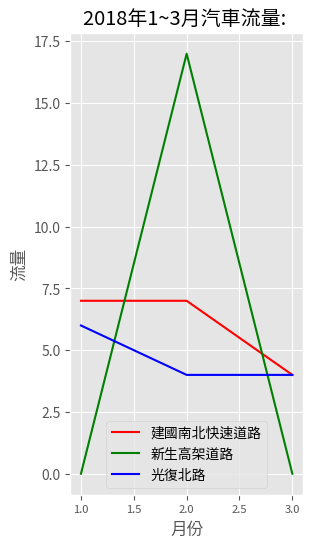

In [23]:
fig = plt.figure(figsize=(3,6))
plt.style.use("ggplot")
# plt.bar(RoadName[list(RoadID).index('200040')] , CARVOLUME[list(RoadID).index('200040')])
plt.plot(CarVolumeMonthList , CarVolumeList, c = 'r') # range(len(CarVolumeList))
plt.plot(CarVolumeMonthList , CarVolumeList2, c = 'g') # range(len(CarVolumeList))
plt.plot(CarVolumeMonthList , CarVolumeList3, c = 'b') # range(len(CarVolumeList))
plt.tick_params(axis='x', labelsize=8)
# plt.xticks(rotation=-20) 
plt.legend(labels=["建國南北快速道路", "新生高架道路", "光復北路"], loc = 'best')
plt.xlabel("月份")
plt.ylabel("流量") 
plt.title("2018年1~3月汽車流量: ") # +df[5][indexRoad7]
plt.grid(True)
fig.savefig('figure.png')